In [1]:
import numpy as np
import pandas as pd

In [3]:
import matplotlib.pyplot as plt
import seaborn as sns

In [7]:
# Reading the dataset
df = pd.read_csv('bank1.csv', sep=';')
df.sample(n=10)

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,convert
38315,38,blue-collar,married,primary,no,1099,yes,no,cellular,15,5,22,5,-1,0
13515,44,entrepreneur,married,tertiary,no,1808,yes,no,cellular,9,7,127,1,-1,0
43445,51,entrepreneur,divorced,tertiary,no,2109,no,no,cellular,12,4,119,1,181,0
21121,32,management,married,tertiary,no,2349,no,no,cellular,14,8,134,5,-1,0
39409,54,management,married,tertiary,no,511,no,no,cellular,22,5,264,2,94,0
2484,45,management,married,tertiary,no,849,no,no,unknown,13,5,60,1,-1,0
36178,48,services,divorced,secondary,no,457,yes,no,cellular,11,5,199,1,326,0
2245,28,technician,single,secondary,no,205,yes,no,unknown,12,5,92,3,-1,0
33,59,blue-collar,married,secondary,no,0,yes,no,unknown,5,5,226,1,-1,0
509,26,admin.,single,secondary,no,712,yes,no,unknown,6,5,232,1,-1,0


Standard syntaxis for creating the plots

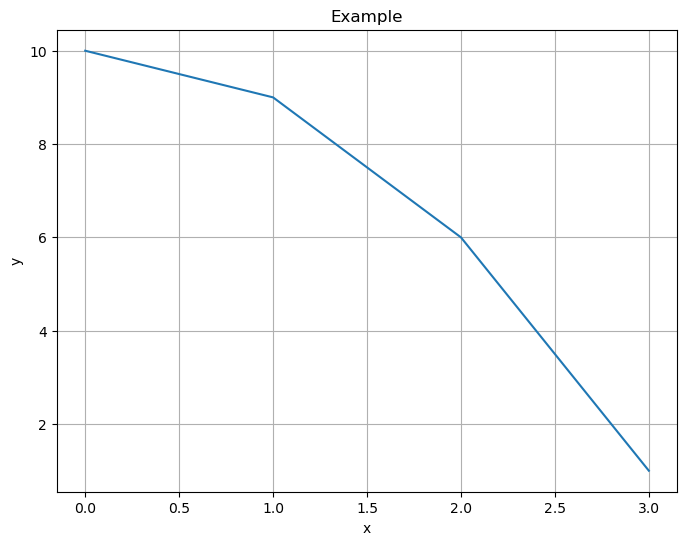

In [5]:
plt.figure(figsize=(8, 6))
plt.plot([0, 1, 2, 3], [10, 9, 6, 1])
plt.xlabel('x')
plt.ylabel('y')
plt.title('Example')
plt.grid();

## Plots' Types

### Linear plot

In [8]:
# Prepare data for the plot creating a pivot table

data = df.groupby('month')['job'].agg(count='count').reset_index().sort_values(by='month')
data.head()

,month,count
0,1,1403
1,2,2649
2,3,477
3,4,2932
4,5,13766


#### Matplotlib

Text(0, 0.5, 'Number of clients')

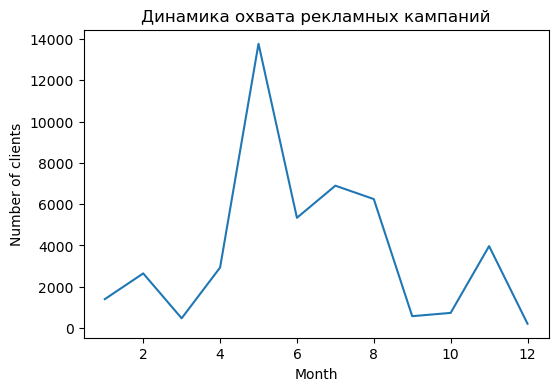

In [9]:
plt.figure(figsize=(6, 4))

plt.plot(data['month'], data['count'])

plt.title('Динамика охвата рекламных кампаний')
plt.xlabel('Month')
plt.ylabel('Number of clients')

#### Seaborn

Text(0, 0.5, 'Number of clients')

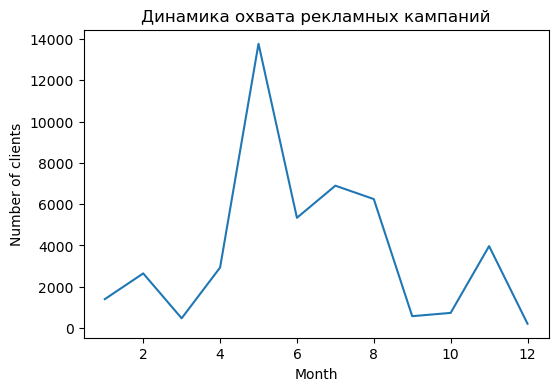

In [10]:
plt.figure(figsize=(6, 4))

sns.lineplot(x=data['month'], y=data['count'])

plt.title('Динамика охвата рекламных кампаний')
plt.xlabel('Month')
plt.ylabel('Number of clients')

### Histogram

#### Matplotlib

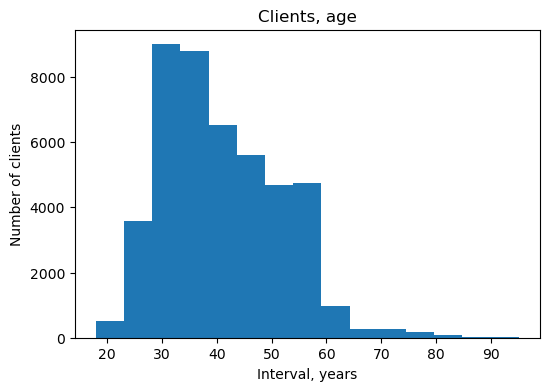

In [14]:
plt.figure(figsize=(6, 4))

plt.hist(df['age'], bins=15)

plt.title('Clients, age')
plt.xlabel('Interval, years')
plt.ylabel('Number of clients');

#### Seaborn

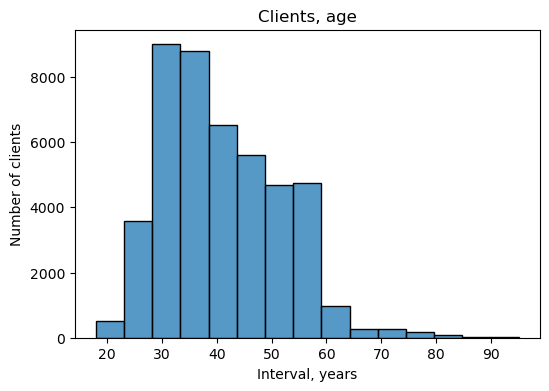

In [15]:
plt.figure(figsize=(6, 4))

sns.histplot(df['age'], bins=15)

plt.title('Clients, age')
plt.xlabel('Interval, years')
plt.ylabel('Number of clients');

### Scatterplot

In [16]:
# Prepare data as a pivot table for the plot
data = df.groupby('age')['convert'].sum().reset_index()
data.head()

,age,convert
0,18,7
1,19,11
2,20,15
3,21,22
4,22,40


#### Matplotlib

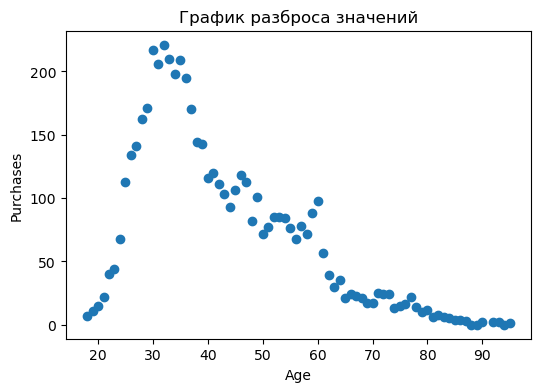

In [17]:
plt.figure(figsize=(6, 4))

plt.scatter(data['age'], data['convert'])

plt.title('График разброса значений')
plt.xlabel('Age')
plt.ylabel('Purchases');

#### Seaborn

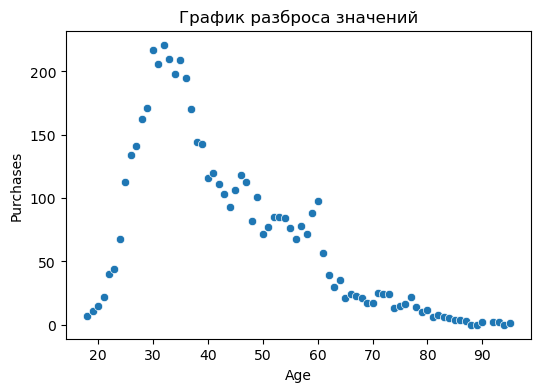

In [19]:
plt.figure(figsize=(6, 4))

sns.scatterplot(x=data['age'], y=data['convert'])

plt.title('График разброса значений')
plt.xlabel('Age')
plt.ylabel('Purchases');

### Bar charts

In [22]:
# Prepare data for the chart
data = df['job'].value_counts().reset_index()
data.head()

,job,count
0,blue-collar,9732
1,management,9458
2,technician,7597
3,admin.,5171
4,services,4154


#### Matplotlib

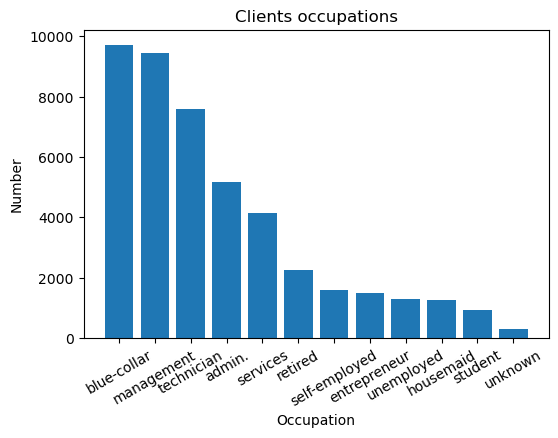

In [23]:
plt.figure(figsize=(6, 4))

plt.bar(data['job'], data['count'])

plt.title('Clients occupations')
plt.xlabel('Occupation')
plt.ylabel('Number')
plt.xticks(rotation=30);

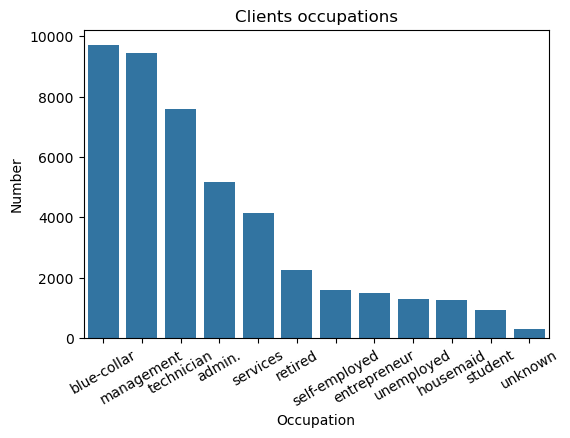

In [24]:
plt.figure(figsize=(6, 4))

sns.barplot(x=data['job'], y=data['count'])

plt.title('Clients occupations')
plt.xlabel('Occupation')
plt.ylabel('Number')
plt.xticks(rotation=30);

#### Многорядовые столбчатые диаграммы

In [26]:
# prepare data for the chart
data = pd.crosstab(df['job'], df['convert']).reset_index().sort_values(by=0, ascending=False)
data.rename(columns={0: 'no', 1: 'yes'}, inplace=True)
data.head()

convert,job,no,yes
1,blue-collar,9024,708
4,management,8157,1301
9,technician,6757,840
0,admin.,4540,631
7,services,3785,369


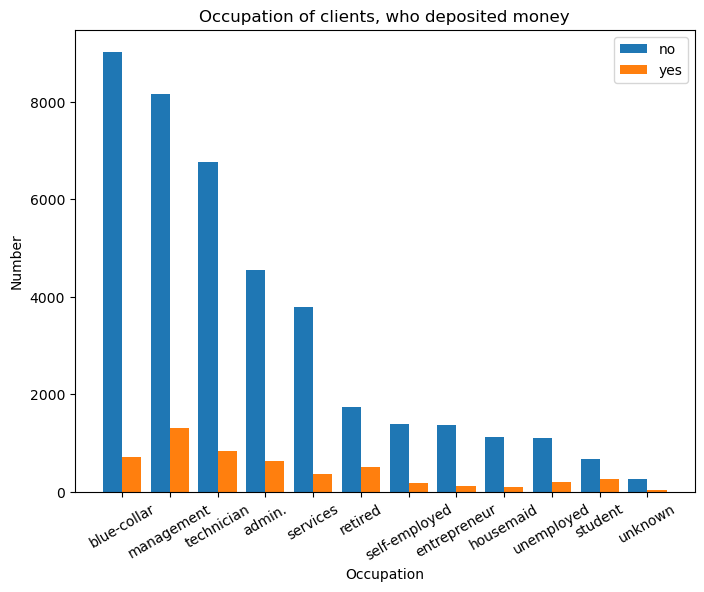

In [28]:
# Building the chart
plt.figure(figsize=(8, 6))

# Defining number of ticks
n_ticks = np.arange(len(data['no']))

# Defining offset
offset = 0.2

# Defining columns width
w = 0.4

# Adding offset to the number of ticks
plt.bar(n_ticks - offset, data['no'], width=w)
plt.bar(n_ticks + offset, data['yes'], width=w)

plt.title('Occupation of clients, who deposited money')
plt.xlabel('Occupation')
plt.ylabel('Number')
plt.legend(['no', 'yes'])
plt.xticks(n_ticks, data['job'], rotation=30); 

#### Сложенная столбчатая диаграмма

In [29]:
# prepare data for the chart
data = pd.crosstab(df['job'], df['convert'], normalize='index').reset_index().sort_values(by=0, ascending=False)
data.rename(columns={0: 'no', 1: 'yes'}, inplace=True)
data.head()

convert,job,no,yes
1,blue-collar,0.927250,0.072750
2,entrepreneur,0.917283,0.082717
3,housemaid,0.912097,0.087903
7,services,0.911170,0.088830
9,technician,0.889430,0.110570


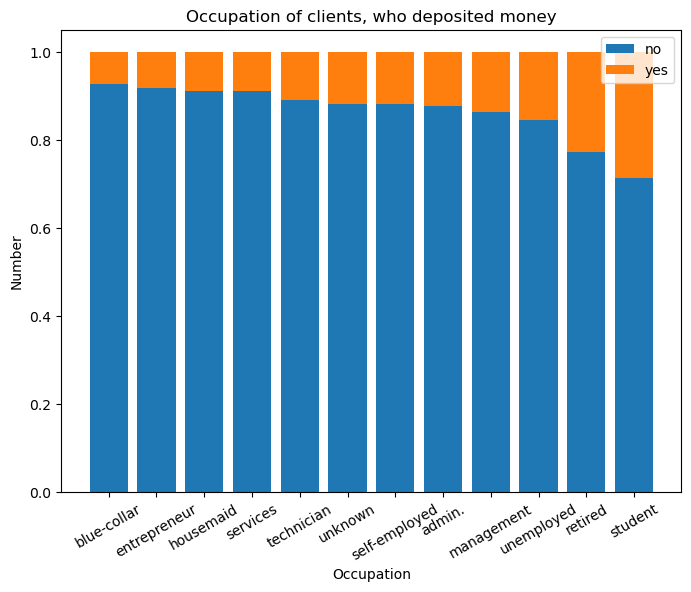

In [30]:
plt.figure(figsize=(8, 6))

plt.bar(data['job'], data['no'])
plt.bar(data['job'], data['yes'], bottom=data['no'])

plt.title('Occupation of clients, who deposited money')
plt.xlabel('Occupation')
plt.ylabel('Number')
plt.legend(['no', 'yes'])
plt.xticks(rotation=30); 

### Box plots

In [51]:
# prepare data
data1 = df['duration'][df['convert'] == 1]
data2 = df['duration'][df['convert'] == 0]
data1.head()

83     1042
86     1467
87     1389
129     579
168     673
Name: duration, dtype: int64

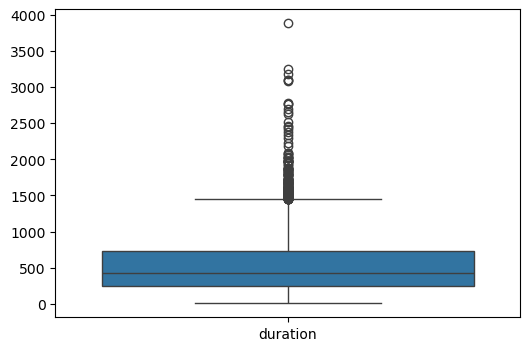

In [32]:
plt.figure(figsize=(6, 4))
sns.boxplot(data=[data1]);

<Axes: xlabel='duration', ylabel='Count'>

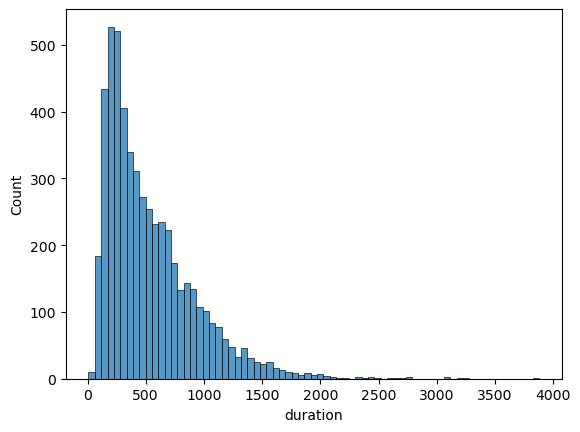

In [34]:
sns.histplot(x=data1)
# box plot is a view from above of histogram

#### Matplotlib

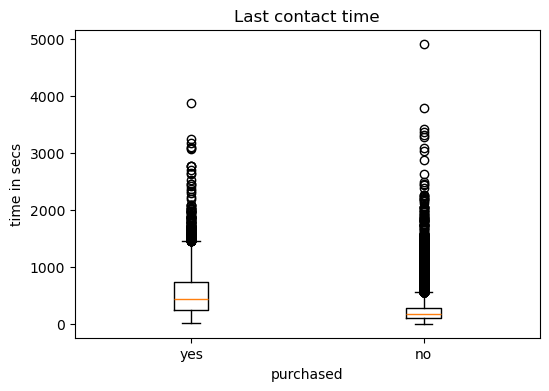

In [35]:
# Building boxplot
plt.figure(figsize=(6, 4))
plt.boxplot([data1, data2])

plt.title('Last contact time')
plt.xlabel('purchased')
plt.ylabel('time in secs')
plt.xticks([1, 2], ['yes', 'no']);

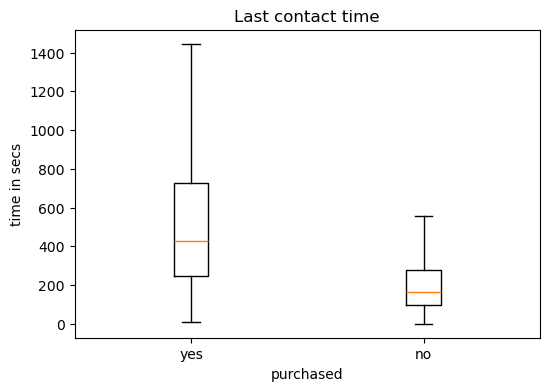

In [60]:
# building boxplot without outliers
plt.figure(figsize=(6, 4))
plt.boxplot([data1, data2], showfliers=False)

plt.title('Last contact time')
plt.xlabel('purchased')
plt.ylabel('time in secs')
plt.xticks([1, 2], ['yes', 'no']);

#### Seaborn

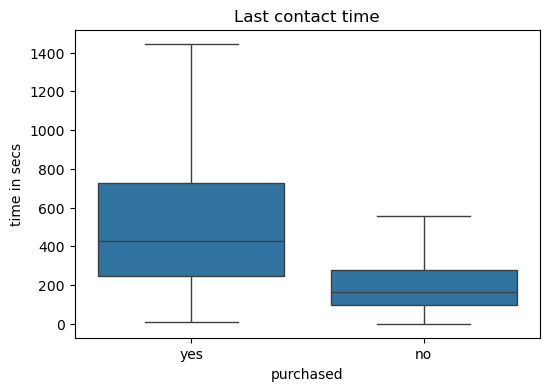

In [61]:
plt.figure(figsize=(6, 4))

sns.boxplot(x=['yes']*len(data1) + ['no']*len(data2), 
            y=pd.concat([data1, data2]), 
            showfliers=False)

plt.title('Last contact time')
plt.xlabel('purchased')

plt.ylabel('time in secs')
plt.xticks([0, 1], ['yes', 'no']);

### Pie chart

In [62]:
data = df['convert'].value_counts()
data.index = ['no', 'yes']
data.head()

no     39922
yes     5289
Name: count, dtype: int64

#### Matplotlib

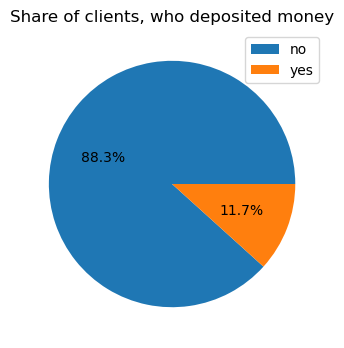

In [65]:
plt.figure(figsize=(6, 4))

plt.pie(data, autopct='%1.1f%%') #float value precisely to 1 digit after comma

plt.title('Share of clients, who deposited money')
plt.legend(data.index);

## Visual data analysis

In [67]:
df = pd.read_csv('housing.csv', sep=',')
df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


### Distribution of material attributes

In [68]:
# {'red', 'green', 'blue'} - дискретный признак ('red', 'green', 'blue', 'red', 'green', 'red')
# [0, 100] - вещественный признак (0, 5, 5.6, 10.5, 10.57)

Text(0, 0.5, 'Amount')

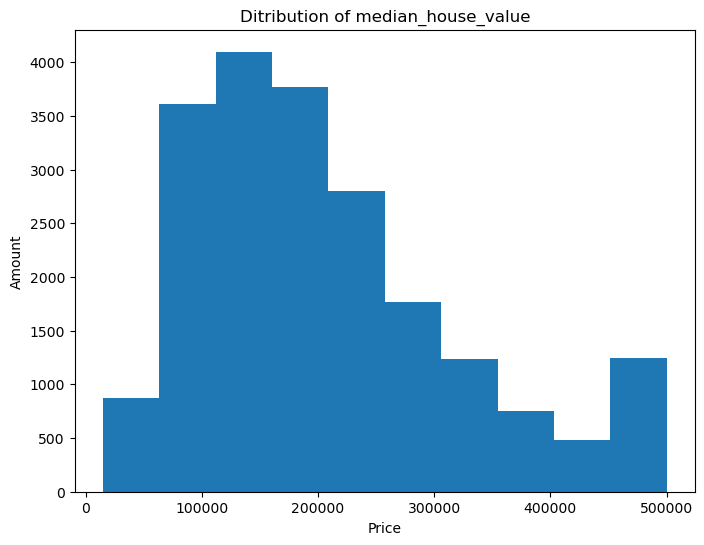

In [69]:
plt.figure(figsize=(8, 6))
plt.hist(df['median_house_value'])
plt.title('Ditribution of median_house_value')
plt.xlabel('Price')
plt.ylabel('Amount')

In [71]:
df_num_features = df.select_dtypes(include=['float64', 'float32', 'float16'])
df_num_features.drop('median_house_value', axis=1, inplace=True)

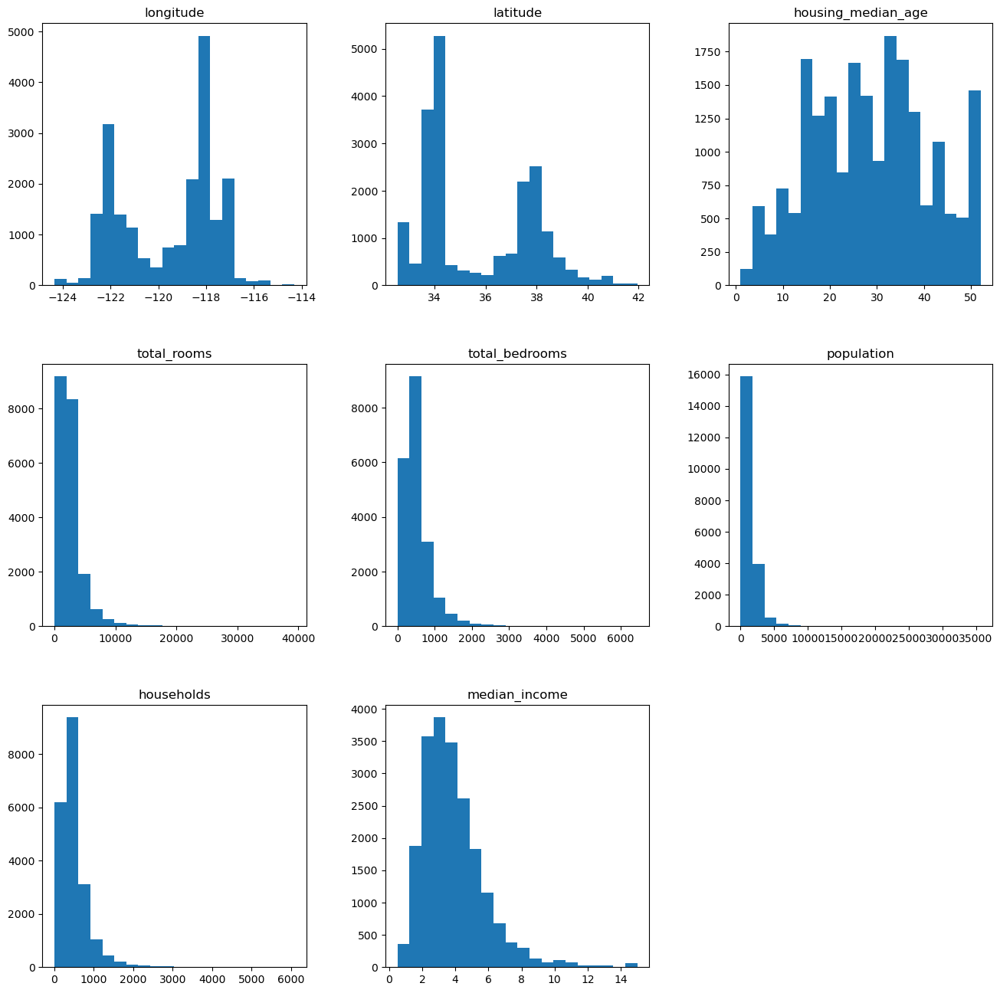

In [72]:
df_num_features.hist(figsize=(16, 16), bins=20, grid=False);

#### Looking for outliers with boxplot

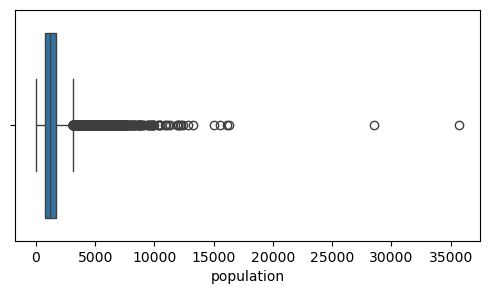

In [73]:
plt.figure(figsize=(6, 3))
sns.boxplot(x=df['population'], whis=1.5)
plt.xlabel('population')
plt.show()

In [74]:
df['INLAND'] = 0
df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,INLAND
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY,0
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY,0
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY,0
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY,0
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY,0


In [82]:
df[df['ocean_proximity'] == 'INLAND']['INLAND'] = 1
df.head()

C:\Users\Administrator\AppData\Local\Temp\ipykernel_24312\2912240459.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[df['ocean_proximity'] == 'INLAND']['INLAND'] = 1


,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,INLAND
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY,0
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY,0
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY,0
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY,0
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY,0


In [85]:
df.loc[df['ocean_proximity'] == 'INLAND','INLAND'] = 1
df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,INLAND
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY,0
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY,0
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY,0
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY,0
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY,0


### Discrete features analysis

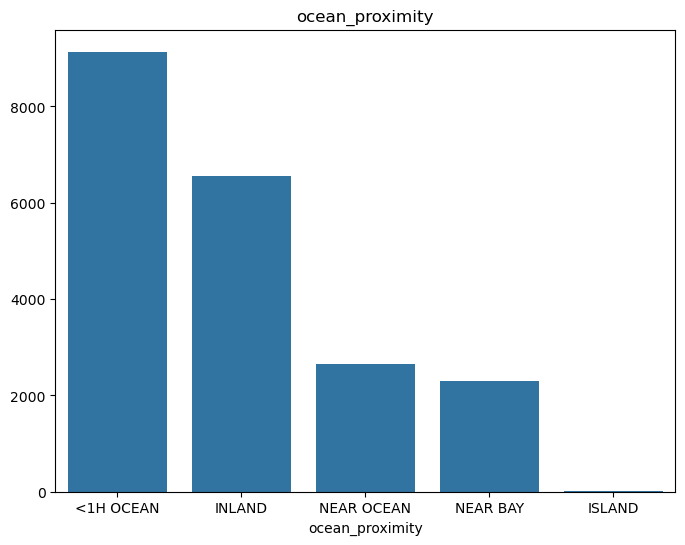

In [86]:
counts = df['ocean_proximity'].value_counts()

plt.figure(figsize=(8, 6))
plt.title('ocean_proximity')
sns.barplot(x=counts.index, y=counts.values)

plt.show()

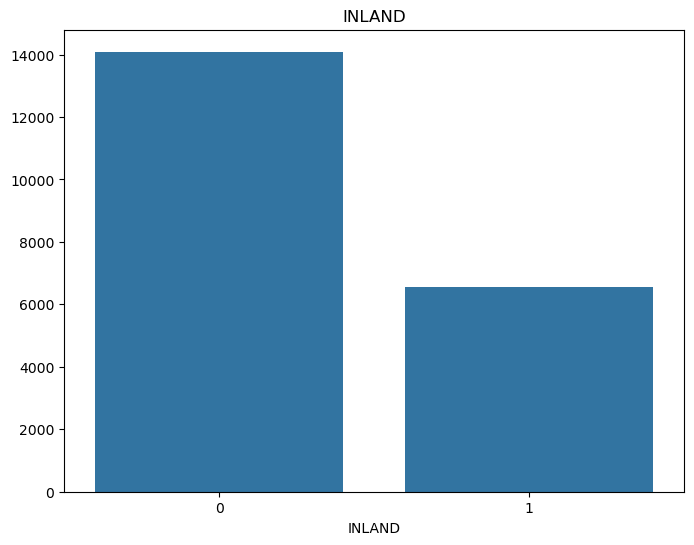

In [87]:
counts = df['INLAND'].value_counts()

plt.figure(figsize=(8, 6))
plt.title('INLAND')
sns.barplot(x=counts.index, y=counts.values)

plt.show()

### Mutual distributions

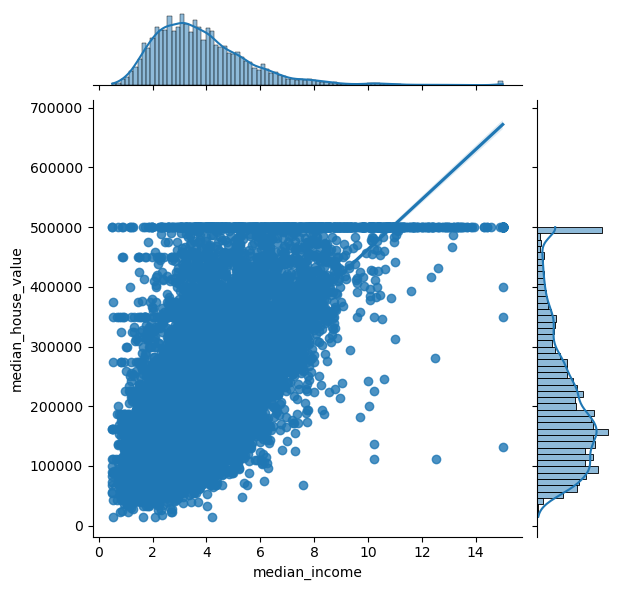

In [88]:
sns.jointplot(x=df['median_income'], y=df['median_house_value'], kind='reg');

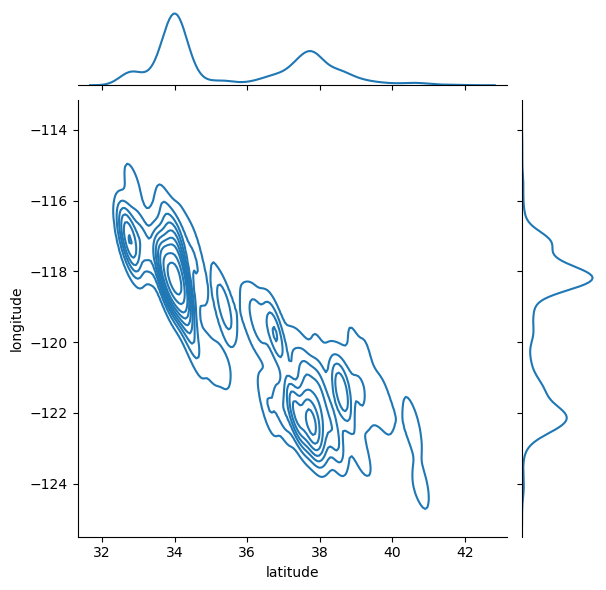

In [89]:
sns.jointplot(x=df['latitude'], y=df['longitude'], kind='kde');

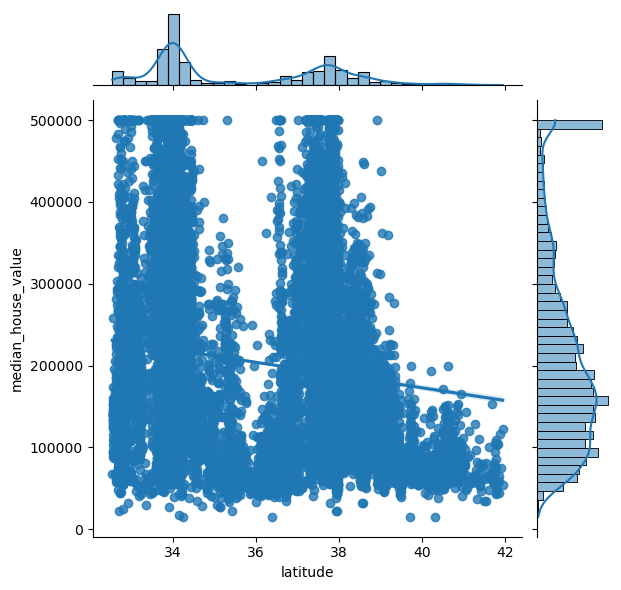

In [90]:
sns.jointplot(x=df['latitude'], y=df['median_house_value'], kind='reg');

It's observable that there are at least 2 cities in the dataset, there is a point to explore them

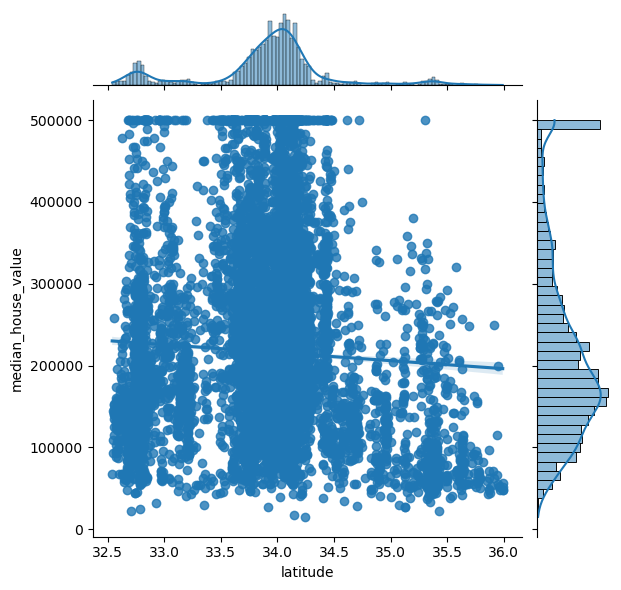

In [92]:
df_cut = df[df['latitude'] < 36]
sns.jointplot(x=df_cut['latitude'], y=df_cut['median_house_value'], kind='reg');

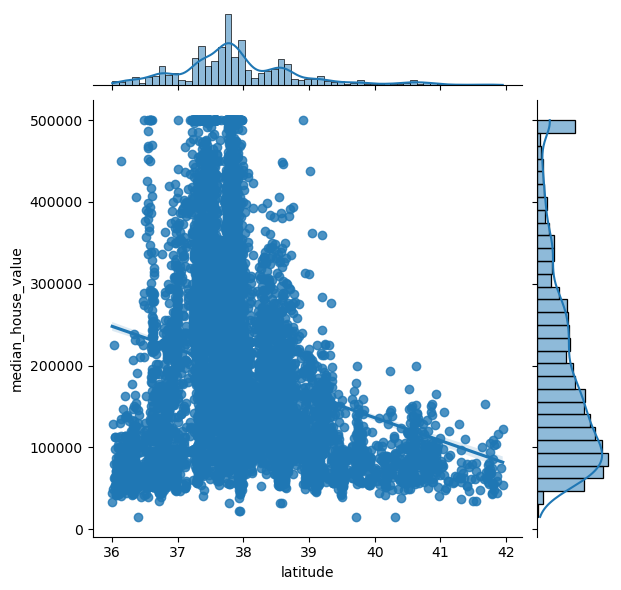

In [93]:
df_cut = df[df['latitude'] >= 36]
sns.jointplot(x=df_cut['latitude'], y=df_cut['median_house_value'], kind='reg');

#### категориальные/бинарные признаки

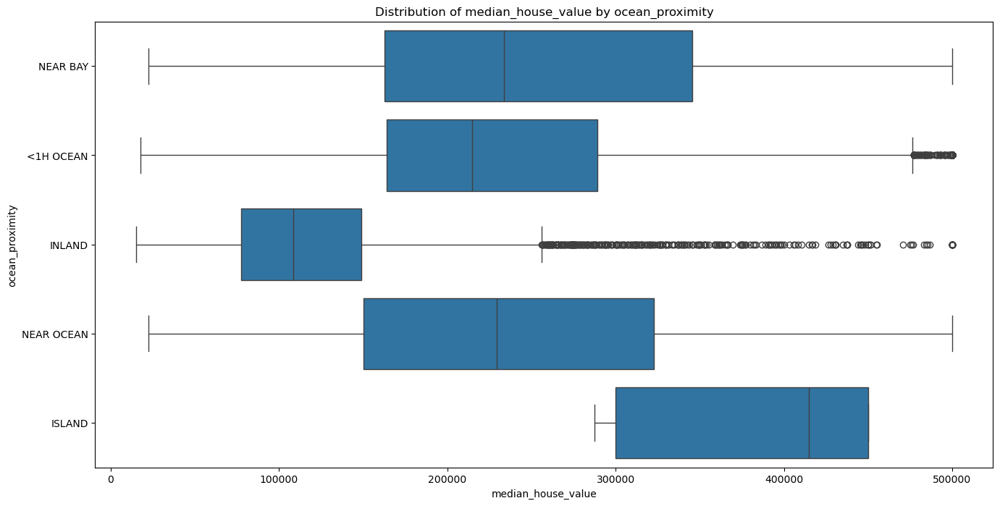

In [94]:
# box plot
plt.figure(figsize=(16, 8))

sns.boxplot(x=df['median_house_value'], y=df['ocean_proximity'], whis=1.5)

plt.xlabel('median_house_value')
plt.ylabel('ocean_proximity')
plt.title('Distribution of median_house_value by ocean_proximity');

### Correlations matrix

* Shows linear connection between variables
* Deviates from -1 to 1
* Correlation is a metric of only linear connection

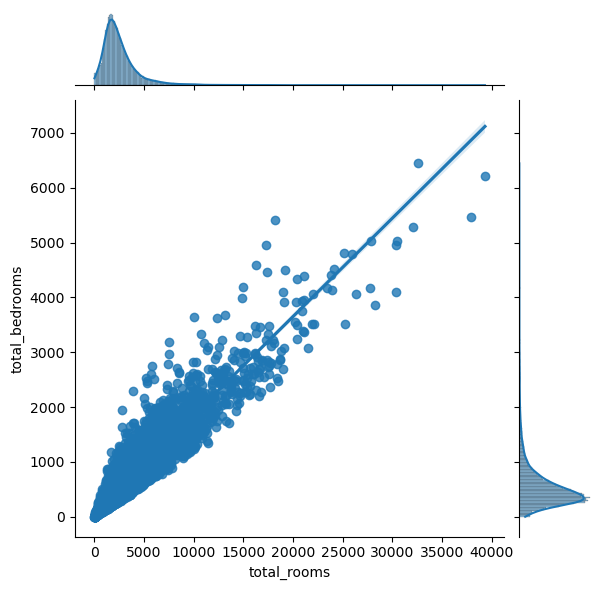

In [96]:
sns.jointplot(x=df['total_rooms'], y=df['total_bedrooms'], kind='reg');

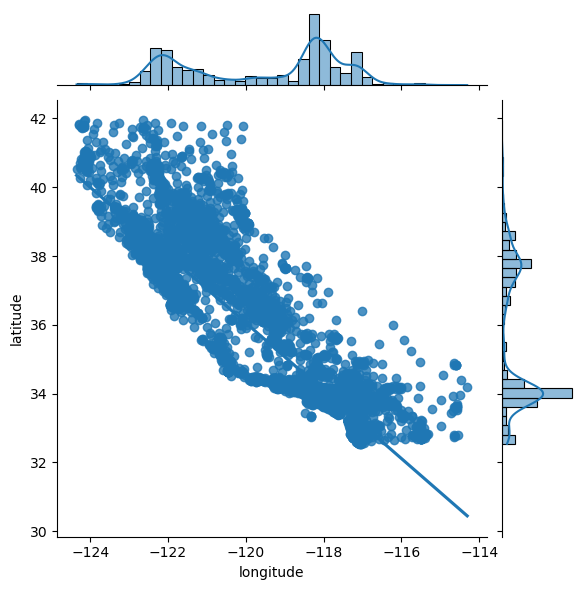

In [97]:
sns.jointplot(x=df['longitude'], y=df['latitude'], kind='reg');

In [102]:
df1 = pd.read_csv('california_housing_test.csv', sep=',')
df1.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
0,-122.05,37.37,27.0,3885.0,661.0,1537.0,606.0,6.6085,344700.0
1,-118.30,34.26,43.0,1510.0,310.0,809.0,277.0,3.5990,176500.0
2,-117.81,33.78,27.0,3589.0,507.0,1484.0,495.0,5.7934,270500.0
3,-118.36,33.82,28.0,67.0,15.0,49.0,11.0,6.1359,330000.0
4,-119.67,36.33,19.0,1241.0,244.0,850.0,237.0,2.9375,81700.0


In [103]:
corr_matrix = df1.corr()
corr_matrix = np.round(corr_matrix, 1)
corr_matrix[np.abs(corr_matrix) < 0.3] = 0
corr_matrix

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
longitude,1.0,-0.9,0.0,0.0,0.0,0.0,0.0,0.0,0.0
latitude,-0.9,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
housing_median_age,0.0,0.0,1.0,-0.4,-0.3,-0.3,-0.3,0.0,0.0
total_rooms,0.0,0.0,-0.4,1.0,0.9,0.8,0.9,0.0,0.0
total_bedrooms,0.0,0.0,-0.3,0.9,1.0,0.9,1.0,0.0,0.0
population,0.0,0.0,-0.3,0.8,0.9,1.0,0.9,0.0,0.0
households,0.0,0.0,-0.3,0.9,1.0,0.9,1.0,0.0,0.0
median_income,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.7
median_house_value,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.7,1.0


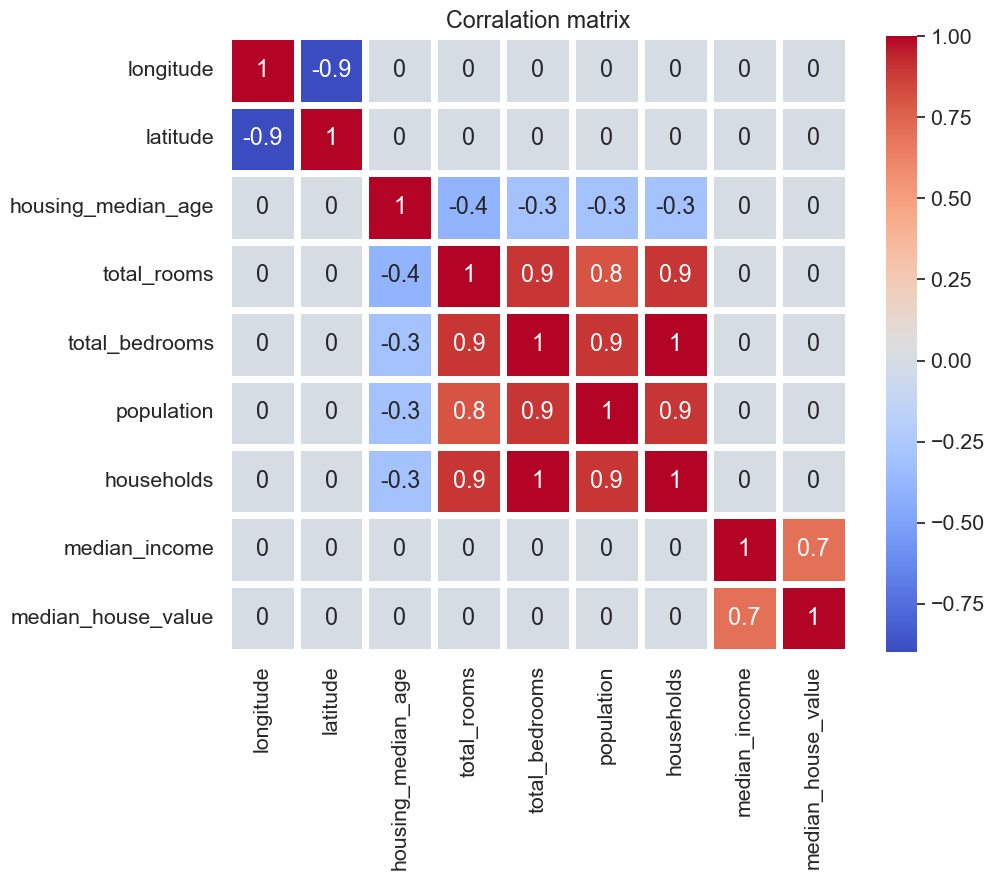

In [104]:
plt.figure(figsize=(10, 8))
sns.set(font_scale=1.4)
sns.heatmap(corr_matrix, annot=True, linewidths=5, cmap='coolwarm')
plt.title('Corralation matrix');

## GEO data

In [105]:
min_long = -124.55
max_long = -113.80

min_lat = 32.45
max_lat = 42.05

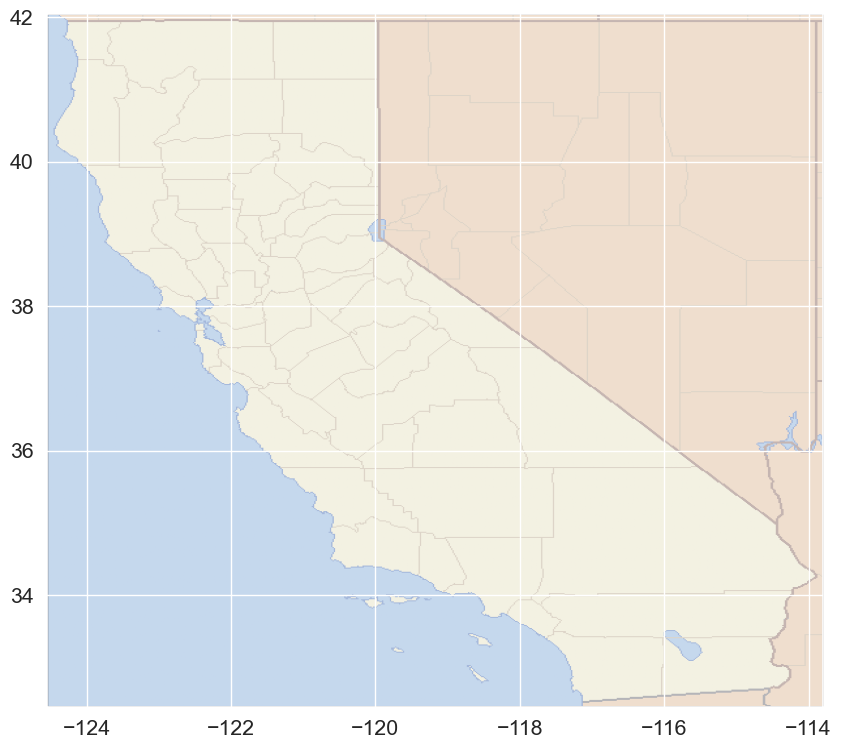

In [106]:
import matplotlib.image as img
california_map = img.imread('California_Map.png')

plt.figure(figsize=(12, 9))
plt.imshow(california_map,
          extent=[min_long, max_long, min_lat, max_lat], alpha=0.5);

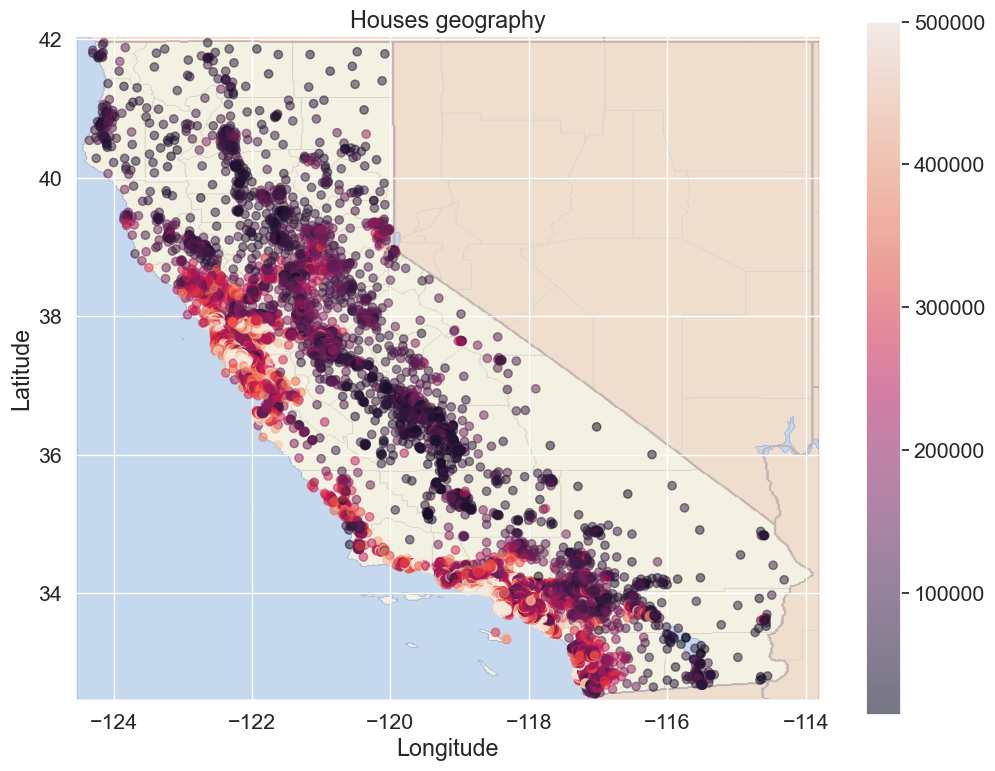

In [108]:
plt.figure(figsize=(12, 9))
sc = plt.scatter(df['longitude'], df['latitude'], alpha=0.5, c=df['median_house_value']) #alpha is about transparency of the dots

plt.imshow(california_map,
          extent=[min_long, max_long, min_lat, max_lat], alpha=0.5)
plt.colorbar(sc)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Houses geography');

## Folium

In [109]:
!pip install folium

In [110]:
import folium
this_map = folium.Map(prefer_canvas=True)

def plot_dot(point):
    folium.CircleMarker(
        location=[point.latitude, point.longitude],
        radius=2,
        popup=point.median_house_value
    ).add_to(this_map)

df.apply(plot_dot, axis=1)

this_map.fit_bounds(this_map.get_bounds())
this_map

### Kepler**

In [112]:
!pip install keplergl==0.1.1

     ---------------------------------------- 0.0/5.4 MB ? eta -:--:--
     - -------------------------------------- 0.3/5.4 MB ? eta -:--:--
     ------- -------------------------------- 1.0/5.4 MB 3.6 MB/s eta 0:00:02
     ------------- -------------------------- 1.8/5.4 MB 3.4 MB/s eta 0:00:02
     ------------------- -------------------- 2.6/5.4 MB 3.7 MB/s eta 0:00:01
     --------------------------- ------------ 3.7/5.4 MB 3.9 MB/s eta 0:00:01
     ------------------------------- -------- 4.2/5.4 MB 3.8 MB/s eta 0:00:01
     ------------------------------------- -- 5.0/5.4 MB 3.7 MB/s eta 0:00:01
     ---------------------------------------- 5.4/5.4 MB 3.7 MB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
   ---------------------------------------- 0.0/1.4 MB ? eta -:--:--
   --------------------- ------------------ 0.8/1.4 MB 6.7 MB/s eta 0:00:01
   ---------------------------------------- 1.4/1.4 MB 5.0 MB/s e

In [117]:
from keplergl import KeplerGl

map_ = KeplerGl(height=700)
map_.add_data(df, 'Data')
map_.save_to_html(file_name='./california.html')

User Guide: https://github.com/keplergl/kepler.gl/blob/master/docs/keplergl-jupyter/user-guide.md
Map saved to ./california.html!


C:\Users\Administrator\anaconda3\envs\PythonForAnalysts\Lib\site-packages\jupyter_client\session.py:721: UserWarning: Message serialization failed with:
Out of range float values are not JSON compliant
Supporting this message is deprecated in jupyter-client 7, please make sure your message is JSON-compliant
  content = self.pack(content)
